# Exploratory Data Analysis

In [1]:
#Importing all modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import ticker 
import pycountry_convert as pc
import folium
import branca
from datetime import datetime, timedelta,date
from scipy.interpolate import make_interp_spline, BSpline
import plotly.express as px
import json, requests
import calmap

from keras.layers import Input, Dense, Activation, LeakyReLU, Dropout
from keras import models
from keras.optimizers import RMSprop, Adam

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [2]:
#loading file using read_csv
df_covid19=pd.read_csv('df_covid19.csv')
df_confirmed=pd.read_csv('df_confirmed.csv')
df_deaths=pd.read_csv('df_deaths.csv')


In [3]:
df_covid19.describe()

,Confirmed,Deaths,Recovered,Mortality Rate,Recovery Rate,Active Cases,Closed Cases,New cases,New deaths,New recovered
count,3.722400e+04,37224.000000,3.722400e+04,37224.000000,37224.000000,3.722400e+04,3.722400e+04,37224.000000,37224.000000,37224.000000
mean,2.707893e+04,1354.377821,1.326754e+04,2.560537,33.493164,1.245701e+04,1.462192e+04,513.583092,19.205969,307.274017
std,1.740854e+05,8016.732878,7.952516e+04,4.325332,34.583260,1.013042e+05,8.577770e+04,3320.411139,117.369856,2312.519394
min,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,-2.000000e+00,0.000000e+00,0.000000,-1918.000000,-16298.000000
25%,3.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,1.000000e+00,0.000000e+00,0.000000,0.000000,0.000000
50%,3.310000e+02,6.000000,5.500000e+01,1.069233,22.448980,1.030000e+02,8.100000e+01,3.000000,0.000000,0.000000
75%,4.403250e+03,93.000000,1.487250e+03,3.510697,64.530062,1.684250e+03,1.811250e+03,84.000000,2.000000,23.000000
max,4.883582e+06,160104.000000,2.230542e+06,100.000000,100.187091,3.124854e+06,2.329035e+06,77255.000000,3887.000000,140050.000000


## General Analysis of Data

Getting country wise and continent wise data.

In [4]:
#Getting continentwise data

df_continents_cases = df_covid19.copy().drop(['country','Closed Cases','New cases','New deaths','New recovered'],axis =1)
df_continents_cases = df_continents_cases.groupby(["continent"]).sum()
df_continents_cases.fillna(0,inplace=True)

In [5]:
df_continents_cases.style.background_gradient(cmap='Blues',subset=["Confirmed"])\
                        .background_gradient(cmap='Reds',subset=["Deaths"])\
                        .background_gradient(cmap='Greens',subset=["Recovered"])\
                        .background_gradient(cmap='Purples',subset=["Active Cases"])\
                        .background_gradient(cmap='Pastel1_r',subset=["Recovery Rate"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate"])\
                        .format("{:.2f}")\
                        .format("{:.0f}",subset=["Confirmed","Deaths","Recovered","Active Cases"])

,Confirmed,Deaths,Recovered,Mortality Rate,Recovery Rate,Active Cases
continent,,,,,,
Africa,37709406,904389,19805801,23529.65,283044.01,16999216
Asia,219219516,5601618,144850378,15027.05,336605.64,68767520
Australia,1337210,16006,982688,419.58,38472.80,338516
Europe,249950948,20723423,120922012,30722.22,313984.74,108305513
North America,312311311,16014189,90841316,13642.47,148984.47,205455806
Others,889051,13722,444799,4978.22,59165.06,430530
South America,186568641,7142013,116023973,6994.25,66492.83,63402655


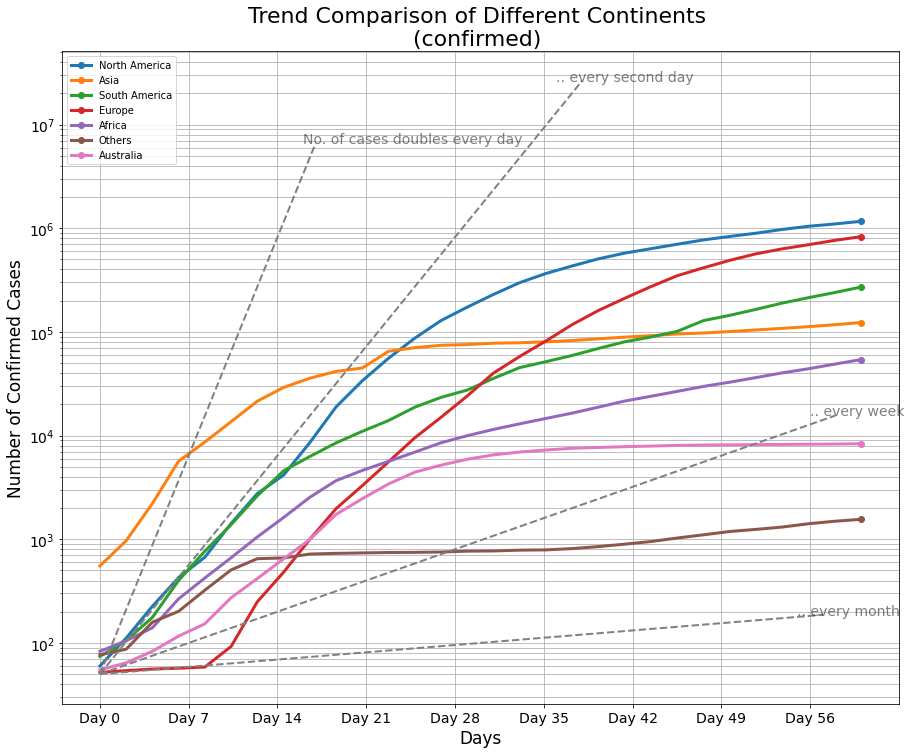

In [6]:
# plots of COVID-19 Spread Comparison of in different Continents
temp = df_confirmed.groupby('continent').sum().drop(["Lat","Long"],axis =1).sort_values(df_confirmed.columns[-1], ascending= False)

threshold = 50
f = plt.figure(figsize=(15,12))
ax = f.add_subplot(111)

for i,country in enumerate(temp.index):
    if i >= 10:
        break
    days = 61
    t = temp.loc[temp.index== country].values[0]
    t = t[t>threshold][:days]
     
    date = np.arange(0,len(t[:days]))
    xnew = np.linspace(date.min(), date.max(), 30)
    spl = make_interp_spline(date, t, k=1)  # type: BSpline
    power_smooth = spl(xnew)
    plt.plot(xnew,power_smooth,'-o',label = country,linewidth =3, markevery=[-1])

plt.tick_params(labelsize = 14)        
plt.xticks(np.arange(0,days,7),[ "Day "+str(i) for i in range(days)][::7])     

# Reference lines 
x = np.arange(0,18)
y = 2**(x+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate("No. of cases doubles every day",(x[-2],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-22)
y = 2**(x/2+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every second day",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-2)
y = 2**(x/7+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every week",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-3)
y = 2**(x/30+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every month",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)


# plot Params
plt.xlabel("Days",fontsize=17)
plt.ylabel("Number of Confirmed Cases",fontsize=17)
plt.title("Trend Comparison of Different Continents \n(confirmed) ",fontsize=22)
plt.legend(loc = "upper left")
plt.yscale("log")
plt.grid(which="both")
plt.savefig('Trend Comparison of continents (Confirmed).png')
plt.show()

## Countrywise reporting cases

In [7]:
df_countries_cases = df_covid19.copy().drop(['continent','Closed Cases','New cases','New deaths','New recovered'],axis =1)
df_countries_cases= df_countries_cases.groupby(["country"]).sum()


In [8]:
#using style.background_gradient
#df_countries_cases.sort_values('Confirmed', ascending= False).style.background_gradient(cmap='Wistia')
df_countries_cases.sort_values('Confirmed',ascending= False).style.background_gradient(cmap='Blues',subset=["Confirmed"])\
                        .background_gradient(cmap='Reds',subset=["Deaths"])\
                        .background_gradient(cmap='Greens',subset=["Recovered"])\
                        .background_gradient(cmap='Purples',subset=["Active Cases"])\
                        .background_gradient(cmap='Pastel1_r',subset=["Recovery Rate"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate"])\
                        .format("{:.2f}")\
                        .format("{:.0f}",subset=["Confirmed","Deaths","Recovered","Active Cases"])


,Confirmed,Deaths,Recovered,Mortality Rate,Recovery Rate,Active Cases
country,,,,,,
USA,270667192,12712324,71099993,769.16,3462.41,186854875
Brazil,116598088,4874345,75028306,694.77,6203.11,36695437
India,58637857,1489724,35492203,416.16,7347.25,21655930
Russia,53872139,759927,31566182,159.63,7621.11,21546030
Spain,30340143,3317656,16597343,1539.13,8277.12,10425144
United Kingdom,29808290,4460192,140638,1943.43,559.59,25207460
Italy,29223661,4059247,17675810,2044.36,7927.04,7488604
Peru,23480144,846483,13785801,435.34,6220.32,8847860
France,23464802,3351191,8000341,2037.64,5066.61,12113270


## Top 10 countries Confirmed,Deaths,Active and recovered cases

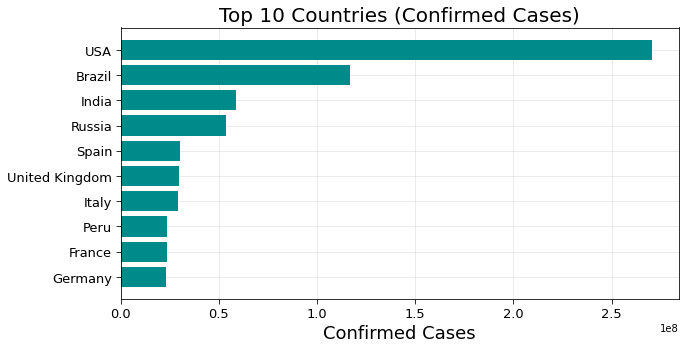

In [9]:
# plot bar of confirmed cases
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_countries_cases.sort_values('Confirmed')["Confirmed"].index[-10:],df_countries_cases.sort_values('Confirmed')["Confirmed"].values[-10:],color="darkcyan")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Confirmed Cases",fontsize=18)
plt.title("Top 10 Countries (Confirmed Cases)",fontsize=20)
plt.grid(alpha=0.3)
plt.savefig('Top 10 Countries (Confirmed Cases).png')

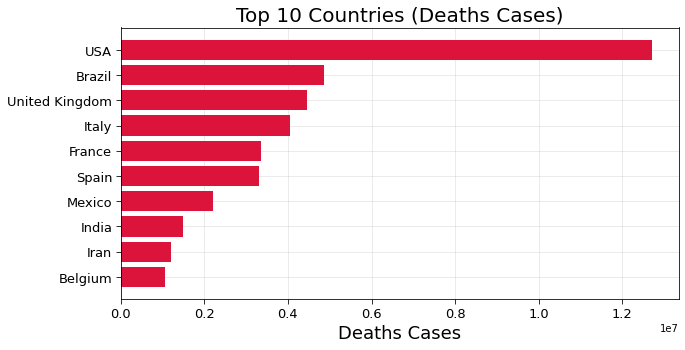

In [10]:
# plot bar of deaths cases
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_countries_cases.sort_values('Deaths')["Deaths"].index[-10:],df_countries_cases.sort_values('Deaths')["Deaths"].values[-10:],color="crimson")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Deaths Cases",fontsize=18)
plt.title("Top 10 Countries (Deaths Cases)",fontsize=20)
plt.grid(alpha=0.3,which='both')
plt.savefig('Top 10 Countries (Deaths Cases).png')

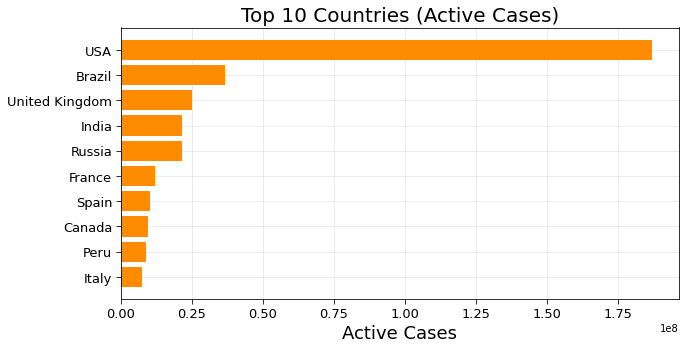

In [11]:
# plot bar of Active cases
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_countries_cases.sort_values('Active Cases')["Active Cases"].index[-10:],df_countries_cases.sort_values('Active Cases')["Active Cases"].values[-10:],color="darkorange")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Active Cases",fontsize=18)
plt.title("Top 10 Countries (Active Cases)",fontsize=20)
plt.grid(alpha=0.3,which='both')
plt.savefig('Top 10 Countries (Active Cases).png')

## Showing the coronavirus spreads¶

In [12]:
#First, let’s import the libraries, load data and select a list of countries and plot interactive plot of confirmed cases

import altair as alt
countries=['US','Brazil','Spain','Germany','China','Russia','India','United Kingdom','Japan']
selected_countries=df_covid19[df_covid19['country'].isin(countries)]
selected_countries=selected_countries.loc[(selected_countries['Date']>'2020-05-01') & (selected_countries['Date']<"2020-08-06")]
#Let’s create a circle chart to display the day wise confirmed cases cases of last 1month,

alt.Chart(selected_countries).mark_circle(filled=True).encode(
    x='monthdate(Date):O',
    y='country:O',
    color='country',
    size=alt.Size('Confirmed:Q',
        scale=alt.Scale(range=[0, 1000]),
        legend=alt.Legend(title='Daily confirmed cases:N')),
    tooltip = [alt.Tooltip('Confirmed')]
   
    
).properties(
    width=800,
    height=300
)
    


alt.Chart(...)

USA,Brazil and India cases are increasing day by day while spain and United Kingdom has uniform in nature. China Germany and Japan has tackled with pandemic as cases seems constant.

## US, India, Brazil and Russia

US and Brazil are experiencing the larger increase in Covid-19 positives in America. At the same time , India, which is secondmost populated country, has increase in the number of cases in short period of time in Asia. The fourth country we will study in this section is Russia which in Europe.

<AxesSubplot:title={'center':'Russia'}, xlabel='Date'>

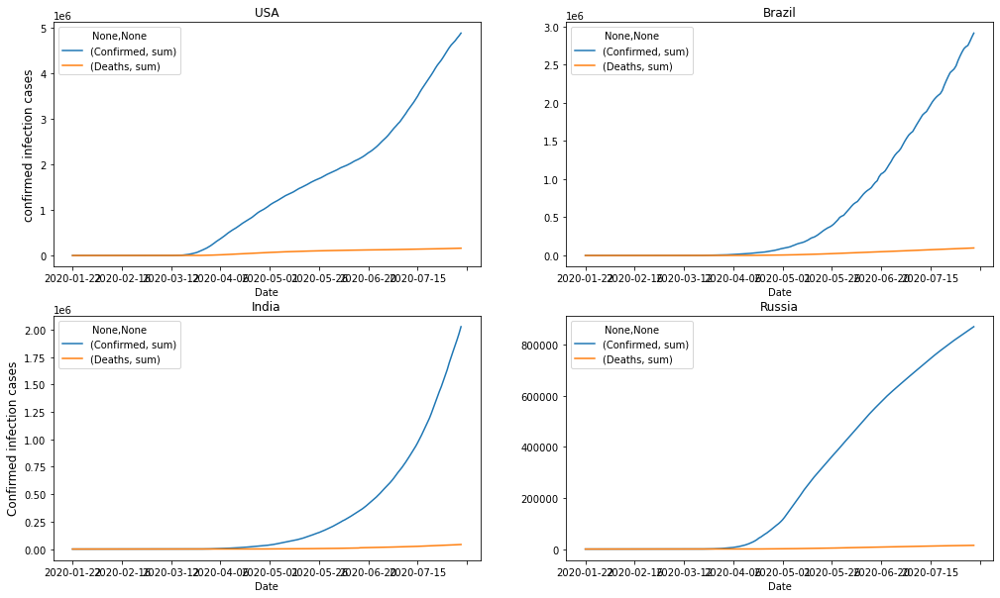

In [13]:
## US, India, Brazil and Russia
#US
confirmed_us = df_covid19[df_covid19['country']=='USA'].groupby(['Date']).agg({'Confirmed':['sum']})
death_us= df_covid19[df_covid19['country']=='USA'].groupby(['Date']).agg({'Deaths':['sum']})
total_date_us = confirmed_us.join(death_us)
#Brazil
confirmed_brazil = df_covid19[df_covid19['country']=='Brazil'].groupby(['Date']).agg({'Confirmed':['sum']})
death_brazil= df_covid19[df_covid19['country']=='Brazil'].groupby(['Date']).agg({'Deaths':['sum']})
total_date_brazil = confirmed_brazil.join(death_brazil)
#India
confirmed_india = df_covid19[df_covid19['country']=='India'].groupby(['Date']).agg({'Confirmed':['sum']})
death_india= df_covid19[df_covid19['country']=='India'].groupby(['Date']).agg({'Deaths':['sum']})
total_date_india = confirmed_india.join(death_india)
#Russia
confirmed_russia = df_covid19[df_covid19['country']=='Russia'].groupby(['Date']).agg({'Confirmed':['sum']})
death_russia= df_covid19[df_covid19['country']=='Russia'].groupby(['Date']).agg({'Deaths':['sum']})
total_date_russia = confirmed_russia.join(death_russia)

# plotting four countries
plt.figure(figsize=(17,10))
plt.subplot(2, 2, 1)
total_date_us.plot(ax=plt.gca(),title='USA')
plt.ylabel("confirmed infection cases",size=12)

plt.subplot(2, 2, 2)
total_date_brazil.plot(ax=plt.gca(),title="Brazil")

plt.subplot(2, 2, 3)
total_date_india.plot(ax=plt.gca(),title="India")
plt.ylabel("Confirmed infection cases",size=12)

plt.subplot(2, 2, 4)
total_date_russia.plot(ax=plt.gca(),title="Russia")

The current epidemic is in a very bad state right now. The number of cases are growing everyday. The entire nation is under lockdown due to the massive number of new cases being reported everyday.  There are currently close to 270667192 confirmed cases in USA.








## Correlation Analysis
plotting heat map of Confirmed,Death,Recovered,Mortality rate, recovery rate nad active cases

In [14]:
# Country wise correlation

df_countries_cases.iloc[:,:].corr().style.background_gradient(cmap='Reds').format("{:.3f}")

,Confirmed,Deaths,Recovered,Mortality Rate,Recovery Rate,Active Cases
Confirmed,1.000,0.927,0.897,0.117,-0.065,0.963
Deaths,0.927,1.000,0.790,0.286,-0.096,0.907
Recovered,0.897,0.790,1.000,0.097,0.030,0.745
Mortality Rate,0.117,0.286,0.097,1.000,-0.265,0.104
Recovery Rate,-0.065,-0.096,0.030,-0.265,1.000,-0.115
Active Cases,0.963,0.907,0.745,0.104,-0.115,1.000


In [15]:
# Continent wise correlation
df_continents_cases.iloc[:,:].corr().style.background_gradient(cmap='Reds').format("{:.3f}")

,Confirmed,Deaths,Recovered,Mortality Rate,Recovery Rate,Active Cases
Confirmed,1.000,0.869,0.874,0.450,0.423,0.920
Deaths,0.869,1.000,0.677,0.614,0.394,0.842
Recovered,0.874,0.677,1.000,0.426,0.533,0.615
Mortality Rate,0.450,0.614,0.426,1.000,0.863,0.361
Recovery Rate,0.423,0.394,0.533,0.863,1.000,0.249
Active Cases,0.920,0.842,0.615,0.361,0.249,1.000


## Visualization  of Map

In [16]:
world_map = folium.Map(location=[10,0], tiles="cartodbpositron", zoom_start=2,max_zoom=6,min_zoom=2)
for i in range(0,len(df_confirmed)):
    folium.Circle(
        location=[df_confirmed.iloc[i]['Lat'], df_confirmed.iloc[i]['Long']],
        tooltip = "<h5 style='text-align:center;font-weight: bold'>"+df_confirmed.iloc[i]['country']+"</h5>"+
                    "<div style='text-align:center;'>"+str(np.nan_to_num(df_confirmed.iloc[i]['state']))+"</div>"+
                    "<hr style='margin:10px;'>"+
                    "<ul style='color: #444;list-style-type:circle;align-item:left;padding-left:20px;padding-right:20px'>"+
        "<li>Confirmed: "+str(df_confirmed.iloc[i,-1])+"</li>"+
        "<li>Deaths:   "+str(df_deaths.iloc[i,-1])+"</li>"+
        "<li>Mortality Rate:   "+str(np.round(df_deaths.iloc[i,-1]/(df_confirmed.iloc[i,-1]+1.00001)*100,2))+"</li>"+
        "</ul>"
        ,
        radius=(int((np.log(df_confirmed.iloc[i,-1]+1.00001)))+0.2)*50000,
        color='#ff6600',
        fill_color='#ff8533',
        fill=True).add_to(world_map)

world_map


In [17]:
# Convert date to string type
df_data = df_covid19.groupby(['Date', 'country'])['Confirmed', 'Deaths'].max().reset_index().fillna(0)
df_data["Date"] = pd.to_datetime( df_data["Date"]).dt.strftime('%m/%d/%Y')

fig = px.scatter_geo(df_data, locations="country", locationmode='country names', 
                     color=np.power(df_data["Confirmed"],0.3)-2 , size= np.power(df_data["Confirmed"]+1,0.3)-1, hover_name="country",
                     hover_data=['Confirmed'],
                     range_color= [0, max(np.power(df_data["Confirmed"],0.3))], 
                     projection="natural earth", animation_frame="Date", 
                     color_continuous_scale=px.colors.sequential.Plasma,
                     title=f'COVID-19: Progression of spread'
                    )


fig.update_coloraxes(colorscale="hot")
fig.update(layout_coloraxis_showscale=True)
fig.update_layout( margin={"r":0,"l":0,"b":0}, height=700,template='plotly_dark')
fig.show()
plt.savefig("COVID-19: Progression of spread")

<Figure size 432x288 with 0 Axes>

In [18]:
# countrywise visual global spread in the world map using choropleth

fi_1 = px.choropleth(df_data, locations="country", locationmode='country names', 
                     color=np.power(df_data["Confirmed"],0.3)-2 , hover_name="country",
                     hover_data=["Confirmed"],
                     range_color= [0, max(np.power(df_data["Confirmed"],0.3))], 
                      animation_frame="Date",
                     color_continuous_scale=px.colors.sequential.Peach
                    )
fi_1.update_geos(fitbounds="locations", visible=True)
fi_1.update_coloraxes(colorscale="jet")
fi_1.update(layout_coloraxis_showscale=True)
fi_1.update_layout( margin={"r":0,"l":0,"b":0}, height=700,template='plotly_dark')

## Global confirmed cases Heat Map

In [19]:
temp_df = pd.DataFrame(df_countries_cases['Confirmed'])

temp_df = temp_df.reset_index()
fig = px.choropleth(temp_df, locations="country",
                    color=np.log10(temp_df["Confirmed"]), # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    hover_data=["Confirmed"],
                    color_continuous_scale=px.colors.sequential.Plasma,locationmode="country names")
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text="Confirmed Cases Heat Map (Log Scale)")
fig.update_coloraxes(colorbar_title="Confirmed Cases(Log Scale)",colorscale="Blues")
# fig.to_image("Global Heat Map confirmed.png")
fig.show()

## Global Deaths cases Heat Map¶

In [20]:
temp_df = pd.DataFrame(df_countries_cases['Deaths'])
temp_df = temp_df.reset_index()
fig = px.choropleth(temp_df, locations="country",
                    color=np.log10(temp_df["Deaths"]+1), # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    hover_data=["Deaths"],
                    color_continuous_scale=px.colors.sequential.Plasma,locationmode="country names")
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text="Deaths Heat Map (Log Scale)")
fig.update_coloraxes(colorbar_title="Deaths (Log Scale)",colorscale="Reds")
# fig.to_image("Global Heat Map deaths.png")
fig.show()

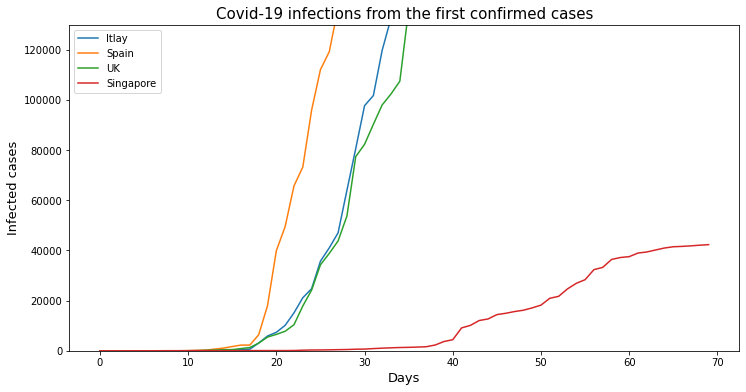

In [21]:
# Italy, UK, Singapore and Spain

#Italy
confirmed_total_date_Italy = df_covid19[(df_covid19['country']=='Italy') & df_covid19['Confirmed']!=0].groupby(['Date']).agg({'Confirmed':['sum']})
death_total_date_Italy = df_covid19[(df_covid19['country']=='Italy') & df_covid19['Confirmed']!=0].groupby(['Date']).agg({'Deaths':['sum']})
total_date_Italy = confirmed_total_date_Italy.join(death_total_date_Italy)

#United Kingdom
confirmed_total_date_uk = df_covid19[(df_covid19['country']=='United Kingdom') & df_covid19['Confirmed']!=0].groupby(['Date']).agg({'Confirmed':['sum']})
death_total_date_uk = df_covid19[(df_covid19['country']=='United Kingdom') & df_covid19['Confirmed']!=0].groupby(['Date']).agg({'Deaths':['sum']})
total_date_uk = confirmed_total_date_uk.join(death_total_date_uk)

#Singapore
confirmed_total_date_singapore = df_covid19[(df_covid19['country']=='Singapore') & df_covid19['Confirmed']!=0].groupby(['Date']).agg({'Confirmed':['sum']})
death_total_date_singapore = df_covid19[(df_covid19['country']=='Singapore') & df_covid19['Confirmed']!=0].groupby(['Date']).agg({'Deaths':['sum']})
total_date_singapore = confirmed_total_date_singapore.join(death_total_date_singapore)

#Spain
confirmed_total_date_spain = df_covid19[(df_covid19['country']=='Spain') & df_covid19['Confirmed']!=0].groupby(['Date']).agg({'Confirmed':['sum']})
death_total_date_spain = df_covid19[(df_covid19['country']=='Spain') & df_covid19['Confirmed']!=0].groupby(['Date']).agg({'Deaths':['sum']})
total_date_spain = confirmed_total_date_spain.join(death_total_date_spain)

# using list comphresion to draw first 70 days data

italy = [i for i in total_date_Italy.Confirmed['sum'].values]
italy_30 = italy[0:70] 
spain = [i for i in total_date_spain.Confirmed['sum'].values]
spain_30 = spain[0:70] 
UK = [i for i in total_date_uk.Confirmed['sum'].values]
UK_30 = UK[0:70] 
singapore = [i for i in total_date_singapore.Confirmed['sum'].values]
singapore_30 = singapore[0:70] 

#plots

plt.figure(figsize=(12,6))
plt.plot(italy_30)
plt.plot(spain_30)
plt.plot(UK_30)
plt.plot(singapore_30)
plt.legend(['Itlay','Spain','UK','Singapore'],loc='upper left')
plt.title("Covid-19 infections from the first confirmed cases"  ,size =15)
plt.xlabel("Days",size=13)
plt.ylabel("Infected cases", size=13)
plt.ylim(0,130000)
plt.show()



## Movering average of 14 days of world covid19 confirmed and Death cases

In [22]:
cols =df_confirmed.keys()
confirmed =df_confirmed.loc[:, cols[4]:cols[-1]]
deaths = df_deaths.loc[:, cols[4]:cols[-1]]
dates = confirmed.keys()


world_cases = []
total_deaths = [] 
mortality_rate = []
total_active = [] 

china_cases = [] 
us_cases = [] 


china_deaths = [] 
us_deaths = [] 


for i in dates:
    confirmed_sum = confirmed[i].sum()
    death_sum = deaths[i].sum()
    
    
    # confirmed, deaths, recovered, and active
    world_cases.append(confirmed_sum)
    total_deaths.append(death_sum)
    mortality_rate.append(death_sum/confirmed_sum)
    
    
    china_cases.append(df_confirmed[df_confirmed['country']=='China'][i].sum())
    us_cases.append(df_confirmed[df_confirmed['country']=='US'][i].sum())
    
    
    china_deaths.append(df_deaths[df_deaths['country']=='China'][i].sum())
    us_deaths.append(df_deaths[df_deaths['country']=='US'][i].sum())
    
    
    
def daily_increase(data):
    d = [] 
    for i in range(len(data)):
        if i == 0:
            d.append(data[0])
        else:
            d.append(data[i]-data[i-1])
    return d 


def moving_average(data, window_size):
    moving_average = []
    for i in range(len(data)):
        if i + window_size < len(data):
            moving_average.append(np.mean(data[i:i+window_size]))
        else:
            moving_average.append(np.mean(data[i:len(data)]))
    return moving_average

# window size
window = 14


# confirmed cases
world_daily_increase = daily_increase(world_cases)
world_confirmed_avg= moving_average(world_cases, window)
world_daily_increase_avg = moving_average(world_daily_increase, window)

china_daily_increase = daily_increase(china_cases)
us_daily_increase = daily_increase(us_cases)  


# deaths
world_daily_death = daily_increase(total_deaths)
world_death_avg = moving_average(total_deaths, window)
world_daily_death_avg = moving_average(world_daily_death, window)

china_daily_death = daily_increase(china_deaths)
us_daily_death = daily_increase(us_deaths) 


    
days_since_1_22 = np.array([i for i in range(len(dates))]).reshape(-1, 1)
world_cases = np.array(world_cases).reshape(-1, 1)
total_deaths = np.array(total_deaths).reshape(-1, 1)
#future forecast
days_in_future = 10
future_forcast = np.array([i for i in range(len(dates)+days_in_future)]).reshape(-1, 1)
adjusted_dates = future_forcast[:-10]
    


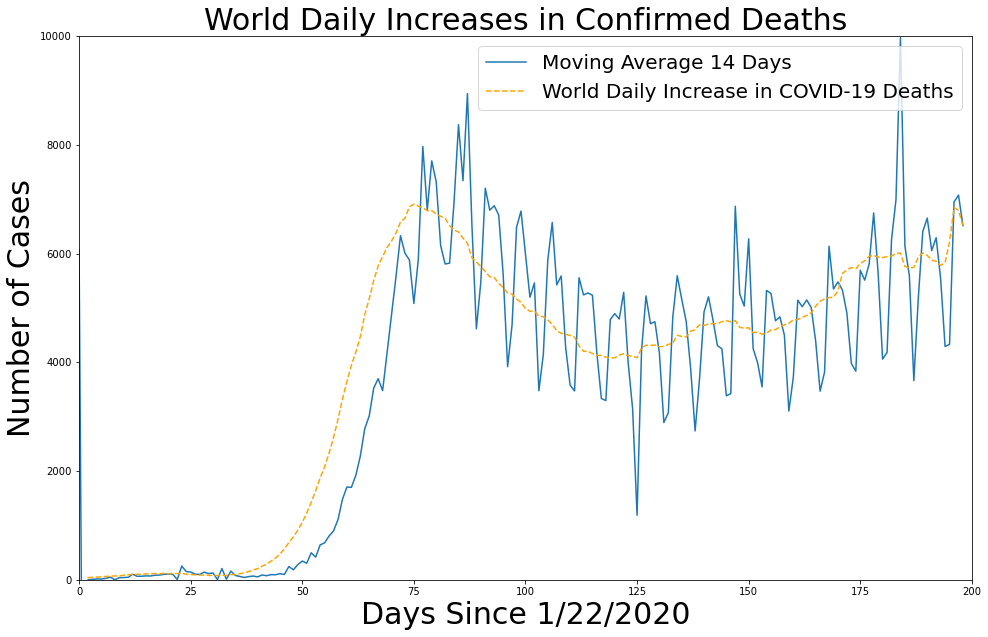

<Figure size 432x288 with 0 Axes>

In [26]:
#plot of world daily increase in confirmed deaths

plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, world_daily_death)
plt.plot(adjusted_dates, world_daily_death_avg, color='orange', linestyle='dashed')
plt.title('World Daily Increases in Confirmed Deaths', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('Number of Cases', size=30)
plt.legend(['Moving Average 14 Days', 'World Daily Increase in COVID-19 Deaths'], prop={'size': 20})
plt.xticks(size=10)
plt.yticks(size=10)
plt.ylim(0,10000)
plt.xlim(0,200)
plt.show()
plt.savefig("World Daily Increases in Confirmed Deaths")

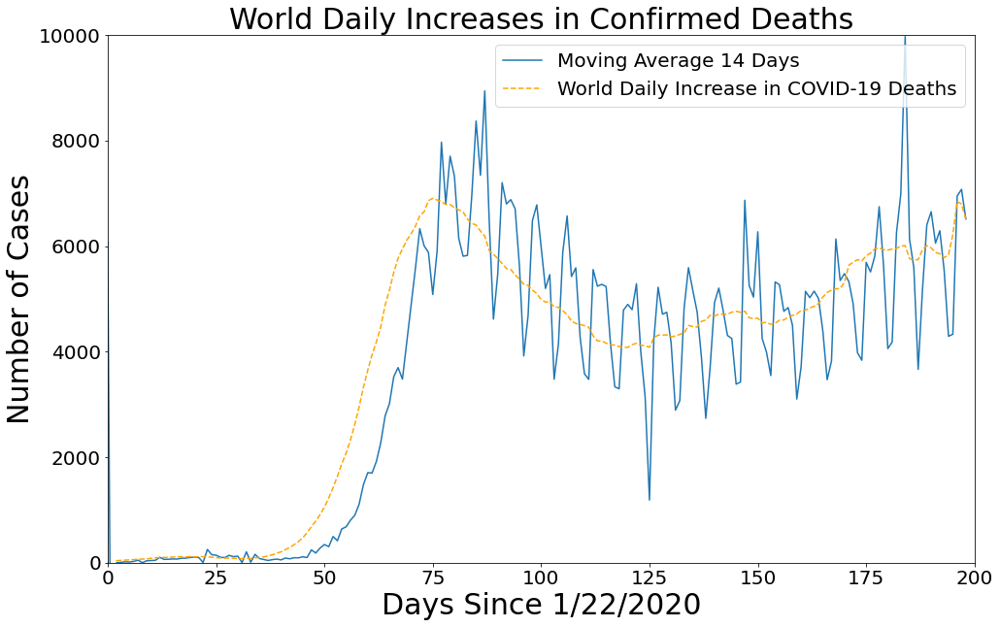

In [55]:
plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, world_daily_death)
plt.plot(adjusted_dates, world_daily_death_avg, color='orange', linestyle='dashed')
plt.title('World Daily Increases in Confirmed Deaths', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('Number of Cases', size=30)
plt.legend(['Moving Average 14 Days', 'World Daily Increase in COVID-19 Deaths'], prop={'size': 20})
plt.xticks(size=20)
plt.yticks(size=20)
plt.xlim(0,200)
plt.ylim(0,10000)
plt.show()

In [ ]:
#plotting China cases
confirmed_avg = moving_average(china_daily_increase, window)
confirmed_increase_avg = moving_average(confirmed_avg, window)
plt.figure(figsize=(12, 8))
plt.plot(adjusted_dates,china_daily_increase)
plt.plot(adjusted_dates,confirmed_increase_avg , color='red', linestyle='dashed')
plt.title( "Confirmed Cases of china", size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('Number of Cases', size=30)
plt.legend(['confirmed cases of china', 'Moving Average 14 Days'], prop={'size': 20})
plt.xticks(size=20)
plt.yticks(size=20)
plt.xlim(0,200)
plt.ylim(0,15000)
plt.show()
#plt.savefig("Confirmed cases in China")

China has been able to "flatten the curve" looking at their graphs of Confirmed Cases.

## Daily increase in different types of Cases"

In [52]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
df_dataa=df_covid19.groupby("Date").agg({"Confirmed":'sum',"Recovered":'sum',"Deaths":'sum'})
fig=go.Figure()
fig.add_trace(go.Scatter(x=df_dataa.index, y=df_dataa["Confirmed"].diff().fillna(0),mode='lines+markers',
                    name='Confirmed Cases'))
fig.add_trace(go.Scatter(x=df_dataa.index, y=df_dataa["Recovered"].diff().fillna(0),mode='lines+markers',
                    name='Recovered Cases'))
fig.add_trace(go.Scatter(x=df_dataa.index, y=df_dataa["Deaths"].diff().fillna(0),mode='lines+markers',
                    name='Death Cases'))
fig.update_layout(title="Daily increase in different types of Cases",
                 xaxis_title="Date",yaxis_title="Number of Cases",legend=dict(x=0,y=1,traceorder="normal"))
fig.show()

Although ,the cases are increasing ,deaths are considerably low.

## Mortality and Recovery Rate 

In [35]:
#Plotting Mortality and Recovery Rate 
from plotly.subplots import make_subplots
import plotly.graph_objects as go
df_dataa= df_covid19.groupby("Date").agg({"Confirmed":'sum',"Recovered":'sum',"Deaths":'sum'})
fig = make_subplots(rows=2, cols=1,
                   subplot_titles=("Recovery Rate", "Mortatlity Rate"))
fig.add_trace(
    go.Scatter(x=df_dataa.index, y=(df_dataa["Recovered"]/df_dataa["Confirmed"])*100,name="Recovery Rate"),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(x=df_dataa.index, y=(df_dataa["Deaths"]/df_dataa["Confirmed"])*100,name="Mortality Rate"),
    row=2, col=1
)
fig.update_layout(height=1000,legend=dict(x=-0.1,y=1.2,traceorder="normal"))
fig.update_xaxes(title_text="Date", row=1, col=1)
fig.update_yaxes(title_text="Recovery Rate", row=1, col=1)
fig.update_xaxes(title_text="Date", row=1, col=2)
fig.update_yaxes(title_text="Mortality Rate", row=1, col=2)
fig.show()
plt.savefig("recovery rate")

<Figure size 432x288 with 0 Axes>

## Comparision of Covid_19 confirmed cases :China vs rest of world

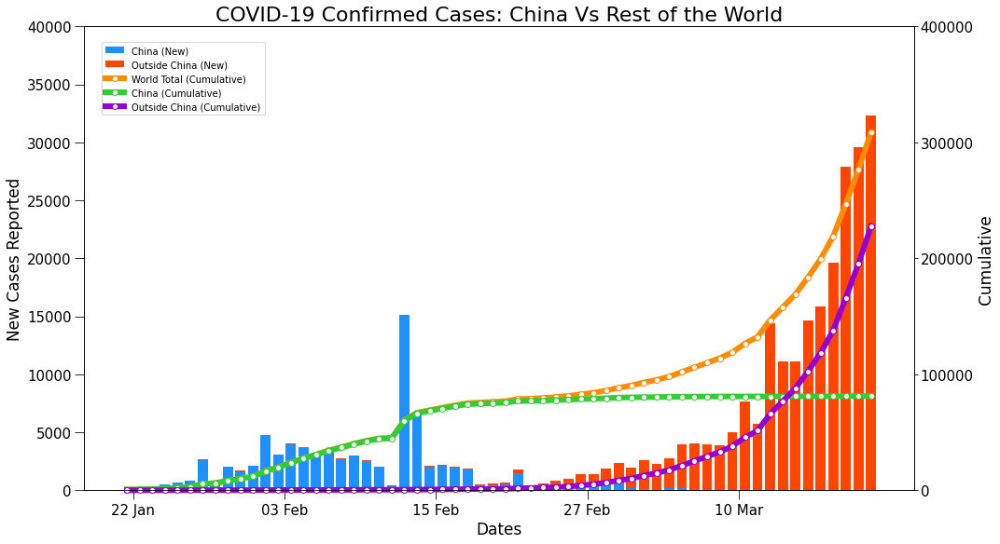

In [36]:
#Getting data for China and Oouside China
#df - Cumulative data for china, outside china and world total  (confirmed cases)
#df_newcases- new cases reported per day  (confirmed cases)

df_confirmed_report =df_confirmed.iloc[:,:65].copy()
df_confirmed_report.loc[df_confirmed_report['country'] != "China","country"] = "Outside China"
df_confirmed_report = df_confirmed_report.groupby("country").sum().drop(["Lat","Long"],axis =1)
df_confirmed_report.loc["Total"] = df_confirmed_report.sum()
df_confirmed_newcases = df_confirmed_report.groupby(level =0).diff(axis =1)
df_confirmed_newcases = df_confirmed_newcases.replace(np.nan, 0, regex=True) 
f = plt.figure(figsize=(15,8))
ax1 = f.add_subplot(111)

ax1.bar(df_confirmed_report[df_confirmed_report.index == "China"].columns,df_confirmed_newcases[df_confirmed_newcases.index == "China"].values[0], label = "China (New)",color='dodgerblue')
ax1.bar(df_confirmed_report[df_confirmed_report.index == "Outside China"].columns,df_confirmed_newcases[df_confirmed_newcases.index == "Outside China"].values[0],bottom=df_confirmed_newcases[df_confirmed_newcases.index == "China"].values[0],label = "Outside China (New)",color='orangered')

# Labels
ax1.set_xlabel("Dates",fontsize=17)
ax1.set_ylabel("New Cases Reported",fontsize =17)

ax1.tick_params(size=10,labelsize=15)
length = len(df_confirmed_report.columns)
ax1.set_xticks(np.arange(0.5, length, int(length/5)))
ax1.set_xticklabels([datetime.strptime(date,'%m/%d/%y').strftime("%d %b") for date in df_confirmed_report.columns][::int(length/5)],fontsize=15)
l = np.arange(0, df_confirmed_report.max(axis = 1)[2]/10+10000, 5000)
ax1.set_yticks(l[::int(len(l)/5)])
# ax1.spines['bottom'].set_position('zero')
ax2 = ax1.twinx()
marker_style = dict(linewidth=6, linestyle='-', marker='o',markersize=6, markerfacecolor='#ffffff')

ax2.plot(df_confirmed_report[df_confirmed_report.index == "Total"].columns ,df_confirmed_report[df_confirmed_report.index == "Total"].values[0],**marker_style,label = "World Total (Cumulative)",color="darkorange",clip_on=False)
ax2.plot(df_confirmed_report[df_confirmed_report.index == "China"].columns ,df_confirmed_report[df_confirmed_report.index == "China"].values[0],**marker_style,label = "China (Cumulative)",color="limegreen",clip_on=False)
ax2.plot(df_confirmed_report[df_confirmed_report.index == "Outside China"].columns ,df_confirmed_report[df_confirmed_report.index == "Outside China"].values[0],**marker_style,label ="Outside China (Cumulative)",color="darkviolet",clip_on=False)
ax2.bar([0],[0])

# Label
ax2.tick_params(labelsize=15)
ax2.set_ylabel("Cumulative",fontsize =17)
ax2.set_xticks(np.arange(0.5, length, int(length/5)))
ax2.set_xticklabels([datetime.strptime(date,'%m/%d/%y').strftime("%d %b") for date in df_confirmed_report.columns][::int(length/5)],fontsize=15)
l = np.arange(0, df_confirmed_report.max(axis = 1)[2]+100000, 100000)
ax2.set_yticks(l[::int(len(l)/5)])

f.tight_layout()
f.legend(loc = "upper left", bbox_to_anchor=(0.1,0.95))
plt.title("COVID-19 Confirmed Cases: China Vs Rest of the World",fontsize = 22)
plt.savefig('China vs Rest of the world.png')
plt.show()



 
## USA
As usa has increased cases allover the world,so I am plotting all cases in usa.

In [37]:

usa_data=df_covid19[df_covid19["country"]=="USA"]
datewise_usa=usa_data.groupby(["Date"]).agg({"Confirmed":'sum',"Recovered":'sum',"Deaths":'sum'})

In [38]:
#plot
fig=go.Figure()
fig.add_trace(go.Scatter(x=datewise_usa.index, y=datewise_usa["Confirmed"].diff().fillna(0),
                    mode='lines+markers',
                    name='Confirmed Cases'))
fig.add_trace(go.Scatter(x=datewise_usa.index, y=datewise_usa["Recovered"].diff().fillna(0),
                    mode='lines+markers',
                    name='Recovered Cases'))
fig.add_trace(go.Scatter(x=datewise_usa.index, y=datewise_usa["Deaths"].diff().fillna(0),
                    mode='lines+markers',
                    name='Death Cases'))
fig.update_layout(title="Daily increase in different types of cases in usa",
                 xaxis_title="Date",yaxis_title="Number of Cases",legend=dict(x=0,y=1,traceorder="normal"))
fig.show()

Eventhough ,the number of cases are increasing we can see deaths are decreased in usa.

## Clustering of Countries

The clustering of countries can be done considering different features. Here I'm trying to cluster different countries based on the Mortality and Recovery rate of indivisual country.

As we all are well aware that COVID-19 has different Mortality Rate among different countries based on different factors and so is the Recovery Rate because of pandemic controlling practices followed by the individual country. Also Mortality Rate and Recovery Rate both togther takes into account all types of cases Confirmed, Recoverd and Deaths.

Let's checkout how these clusters look like!

In [39]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
X=df_covid19[["Mortality Rate","Recovery Rate"]]
#Standard Scaling since K-Means Clustering is a distance based alogrithm
std= StandardScaler()
X=std.fit_transform(X) 

In [40]:
wcss=[]
sil=[]
for i in range(2,11):
    clf=KMeans(n_clusters=i,init='k-means++',random_state=42)
    clf.fit(X)
    labels=clf.labels_
    centroids=clf.cluster_centers_
    sil.append(silhouette_score(X, labels, metric='euclidean'))
    wcss.append(clf.inertia_)

Text(0.5, 1.0, 'Elbow Method')

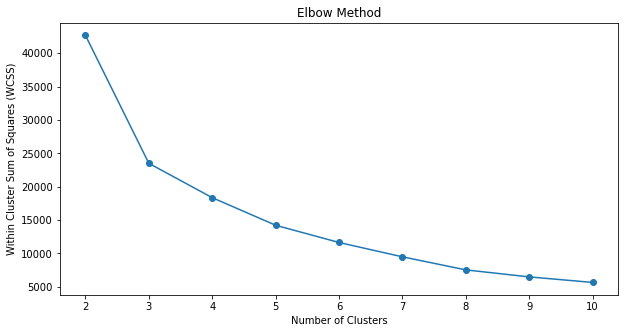

In [41]:
x=np.arange(2,11)
plt.figure(figsize=(10,5))
plt.plot(x,wcss,marker='o')
plt.xlabel("Number of Clusters")
plt.ylabel("Within Cluster Sum of Squares (WCSS)")
plt.title("Elbow Method")

In [42]:
clf_final=KMeans(n_clusters=3,init='k-means++',random_state=6)
clf_final.fit(X)
df_covid19["Clusters"]=clf_final.predict(X)

In [51]:
## SUMMARY OF CLUSTERS
print("Few Countries belonging to Cluster 0: ",list(df_covid19[df_covid19["Clusters"]==0].head(10)['country']))
print("Few Countries belonging to Cluster 1: ",list(df_covid19[df_covid19["Clusters"]==1].head(10)['country']))
print("Few Countries belonging to Cluster 2: ",list(df_covid19[df_covid19["Clusters"]==2].head(10)['country']))


Few Countries belonging to Cluster 0:  ['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia', 'Austria']
Few Countries belonging to Cluster 1:  ['Sri Lanka', 'Sri Lanka', 'Sri Lanka', 'Sri Lanka', 'Cambodia', 'Finland', 'Nepal', 'Russia', 'Sri Lanka', 'Australia']
Few Countries belonging to Cluster 2:  ['Philippines', 'Philippines', 'Philippines', 'Philippines', 'Philippines', 'Philippines', 'Philippines', 'Philippines', 'Philippines', 'Philippines']


In [44]:
fig = px.scatter(df_covid19, x="Recovery Rate", y="Mortality Rate", color="Clusters",
                 size='Clusters', hover_name="Clusters",color_discrete_map={'Recovery Rate': 'lightcyan', 
                                                   'Mortality Rate': 'royalblue', 'Clusters': 'darkblue'})
fig.show()

In [50]:
print("Avergae Mortality Rate of Cluster 0: ",df_covid19[df_covid19["Clusters"]==0]["Mortality Rate"].mean())
print("Avergae Recovery Rate of Cluster 0: ",df_covid19[df_covid19["Clusters"]==0]["Recovery Rate"].mean())
print("Avergae Mortality Rate of Cluster 1: ",df_covid19[df_covid19["Clusters"]==1]["Mortality Rate"].mean())
print("Avergae Recovery Rate of Cluster 1: ",df_covid19[df_covid19["Clusters"]==1]["Recovery Rate"].mean())
print("Avergae Mortality Rate of Cluster 2: ",df_covid19[df_covid19["Clusters"]==2]["Mortality Rate"].mean())
print("Avergae Recovery Rate of Cluster 2: ",df_covid19[df_covid19["Clusters"]==2]["Recovery Rate"].mean())

Avergae Mortality Rate of Cluster 0:  1.1072205889325661
Avergae Recovery Rate of Cluster 0:  7.728973307509244
Avergae Mortality Rate of Cluster 1:  2.5687085347822194
Avergae Recovery Rate of Cluster 1:  72.50337751788645
Avergae Mortality Rate of Cluster 2:  14.562654682780716
Avergae Recovery Rate of Cluster 2:  28.86145303975767


Cluster 2 is a set of countries which have really High Mortality Rate and consdierably Good Recovery Rate. Basically few countries among these clusters have seen already the worst of this pandemic but are now recovering with healty Recovery Rate.

Cluster 0 is set of countries which have Low Mortality Rate and really High Recovery Rate. These are the set of countries who has been able to control the COVID-19 by following pandemic controlling practices rigorously.

Cluster 1 is set of countries which have Low Mortality Rate and Low Recovery Rate. These countries need to pace up their Revovery Rate to get out it, Some thses countries have really high number of Infected Cases but Low Mortality is positive sign out of it.